In [1]:
import numpy as np
import czifile
from pathlib2 import Path
import matplotlib.pyplot as plt
import cv2
from fil_finder import FilFinder2D
import astropy.units as u
import pandas as pd
from tqdm.notebook import tqdm

In [2]:
project_dir = Path('../../../data/2021.02.16')
result_dir = project_dir / 'result_dir'
data_dir = project_dir / 'input_data'
px2mum_mult = 600 / 2048

(2048, 2048)


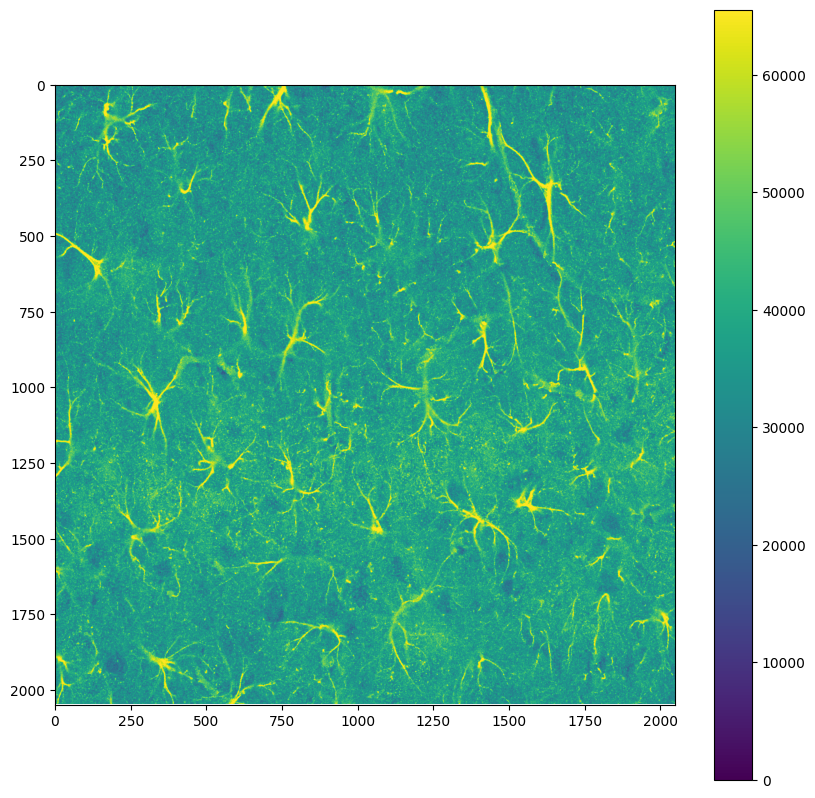

In [3]:
czi_filename = data_dir / "Young1.czi"
images = czifile.imread(czi_filename)
#print(czi_filename.name, im.shape)
images = images.reshape(images.shape[3:6])
im = images[10, :, :].copy()
plt.figure(figsize = (10, 10))
#plt.imshow(im[40, :, :])
mask = (im[:, :] > 3000).astype('uint8')
cur = np.log(im[:, :].astype('float64'))
cur -= cur.min()
mx = 2 ** 16 - 1
cur *= mx / np.quantile(cur.flatten(), 0.99)
cur = np.minimum(cur, mx)
cur = cur.astype('uint16')
print(cur.shape)
plt.imshow(cur)
plt.colorbar()

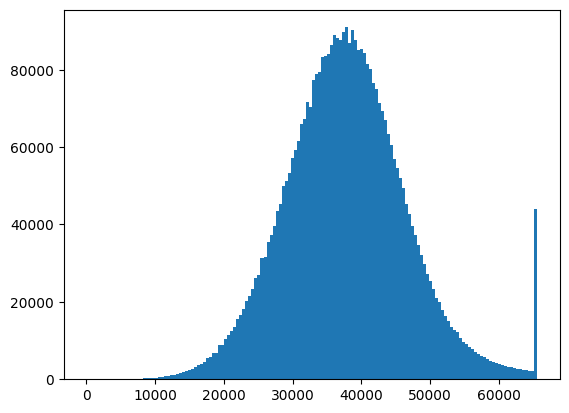

In [4]:
plt.hist(cur.flatten(), bins = 150)
#plt.yscale('log')
#plt.xscale('log')
pass

In [5]:
cur.dtype

dtype('uint16')

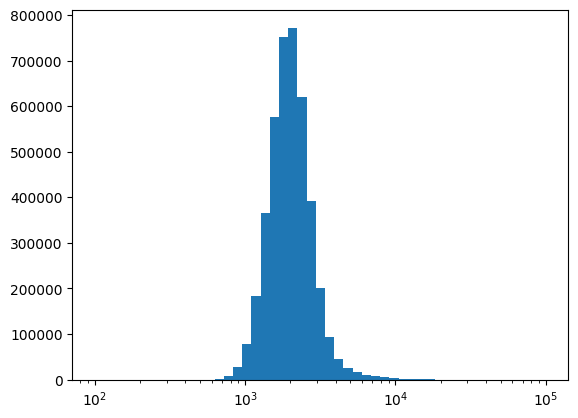

In [6]:
plt.hist(im[:, :].flatten(), bins = np.logspace(2, 5))
#plt.yscale('log')
plt.xscale('log')
pass

c:\ProgramData\Anaconda3\envs\py39\lib\site-packages\fil_finder\filfinder2D.py:142: UserWarning: No beam width given. Using 0 pixels.
  warnings.warn("No beam width given. Using 0 pixels.")


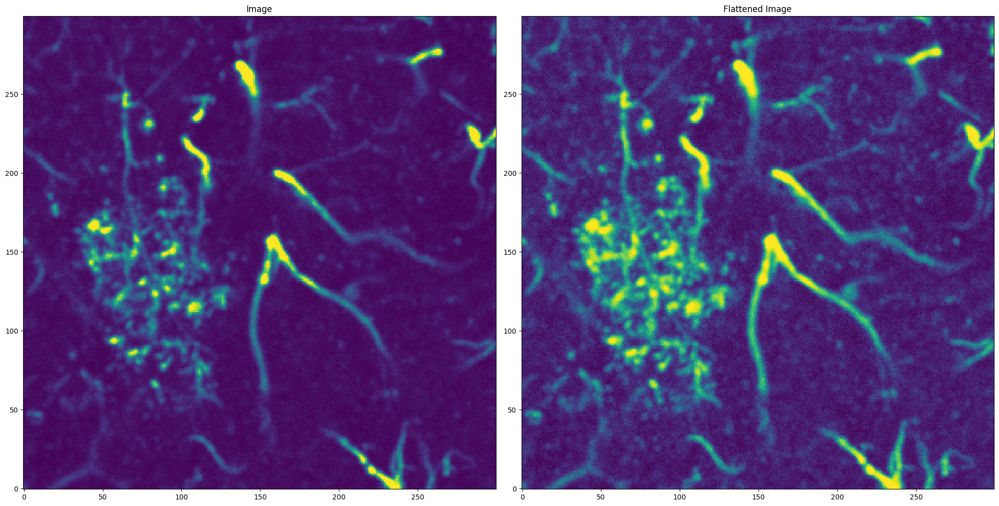

In [7]:
tid = 40
skeleton = (images[tid, :, :] > 3000).astype('uint8')
skeleton = images[tid, :, :]
skeleton = skeleton[:300, :300]

fil = FilFinder2D(skeleton, distance=250 * u.pc) # , mask=skeleton
fil.preprocess_image(flatten_percent=95)
plt.figure(figsize = (20, 10))
plt.subplot(121)
plt.imshow(fil.image.value, origin='lower')
plt.title("Image")
plt.subplot(122)
plt.imshow(fil.flat_img.value, origin='lower')
plt.title("Flattened Image")
plt.tight_layout()

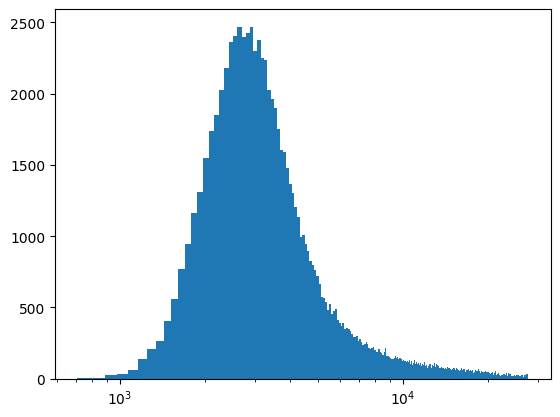

In [8]:
plt.hist(fil.flat_img.value.flatten(), bins = 300)
#plt.yscale('log')
plt.xscale('log')
pass

1
2
3
4


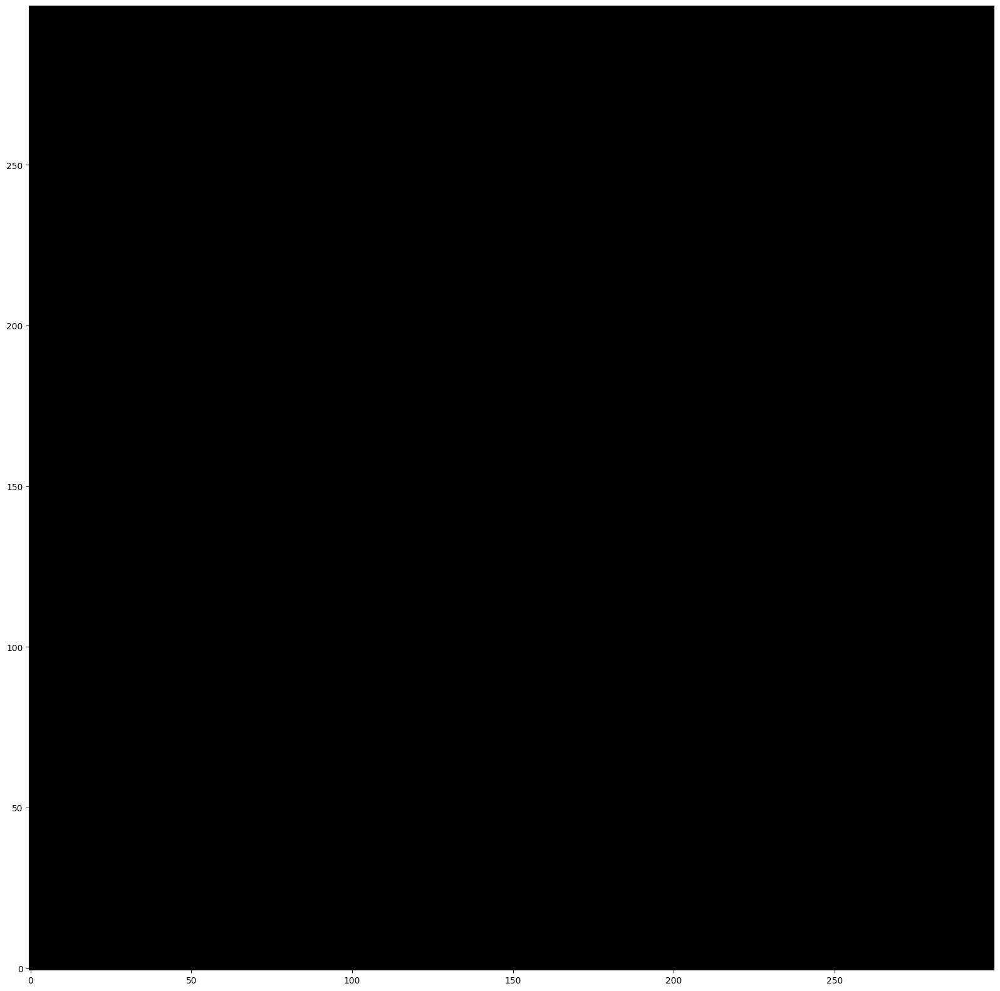

In [9]:
fil = FilFinder2D(skeleton, distance=250 * u.pix) # , mask=skeleton
print(1)
fil.preprocess_image(flatten_percent=95)
print(2)
fil.create_mask(verbose=False,\
                smooth_size = 5 * u.pix, adapt_thresh = 7 * u.pix, \
                size_thresh = 300 * u.pix ** 2, fill_hole_size = 3000 * u.pix ** 2)
#use_existing_mask=False, border_masking=False, 
print(3)
#fil.medskel(verbose=False)
print(4)
#fil.analyze_skeletons(branch_thresh=40* u.pix, skel_thresh=10 * u.pix, prune_criteria='length')
#print(5)

from forest import remove_alone, fill_holes, remove_small

cur = fil.flat_img.value.copy()
#cur[cur < thr] = 0

cur = remove_alone(cur, num_iter = 100)
#cur = remove_small(cur, min_size = 300)
#cur = remove_small(cur, min_size = 300)

cur = fill_holes(cur, 10)

plt.figure(figsize = (20, 20))
cur = remove_small(cur, min_size = 50)
plt.imshow(cur, cmap='gray', origin='lower')

# Show the longest path
#plt.figure(figsize = (20, 20))
#plt.imshow(fil.skeleton, cmap='gray', origin='lower')
#plt.contour(fil.skeleton_longpath, colors='r')
#plt.axis('off')
plt.show()

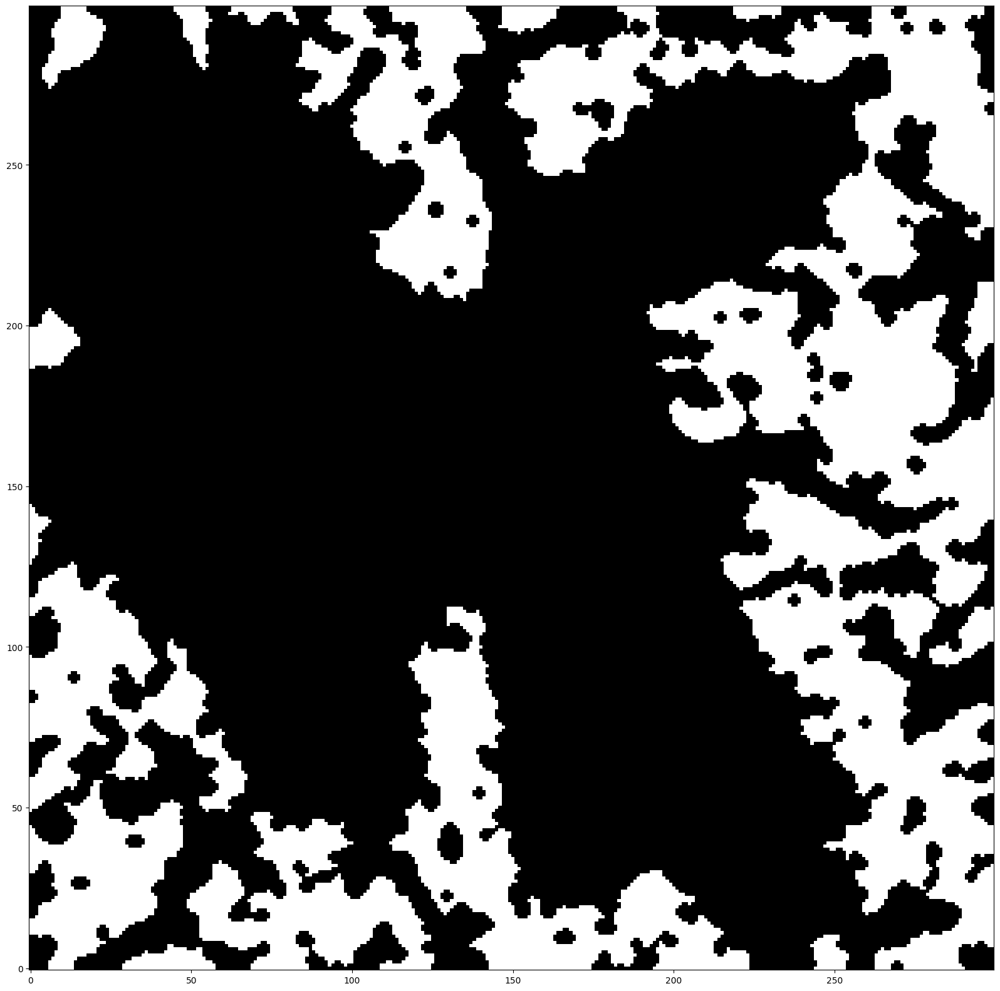

In [10]:
cur = fil.flat_img.value.copy()
thr = 3000
cur[cur < thr] = 0

cur = remove_alone(cur, num_iter = 100)
#cur = remove_small(cur, min_size = 300)
#cur = remove_small(cur, min_size = 300)

cur = fill_holes(cur > 0, 10)

plt.figure(figsize = (20, 20))
cur = remove_small(~cur, min_size = 50)
plt.imshow(cur, cmap='gray', origin='lower')

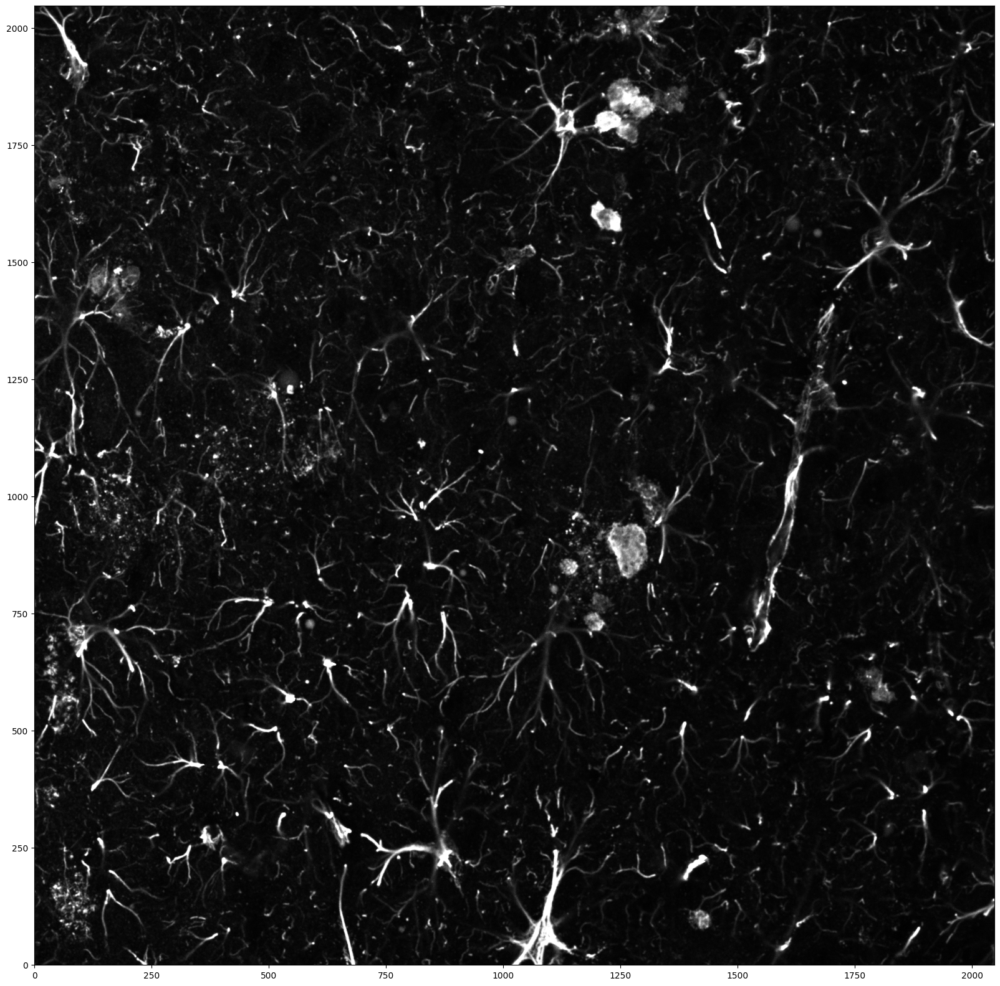

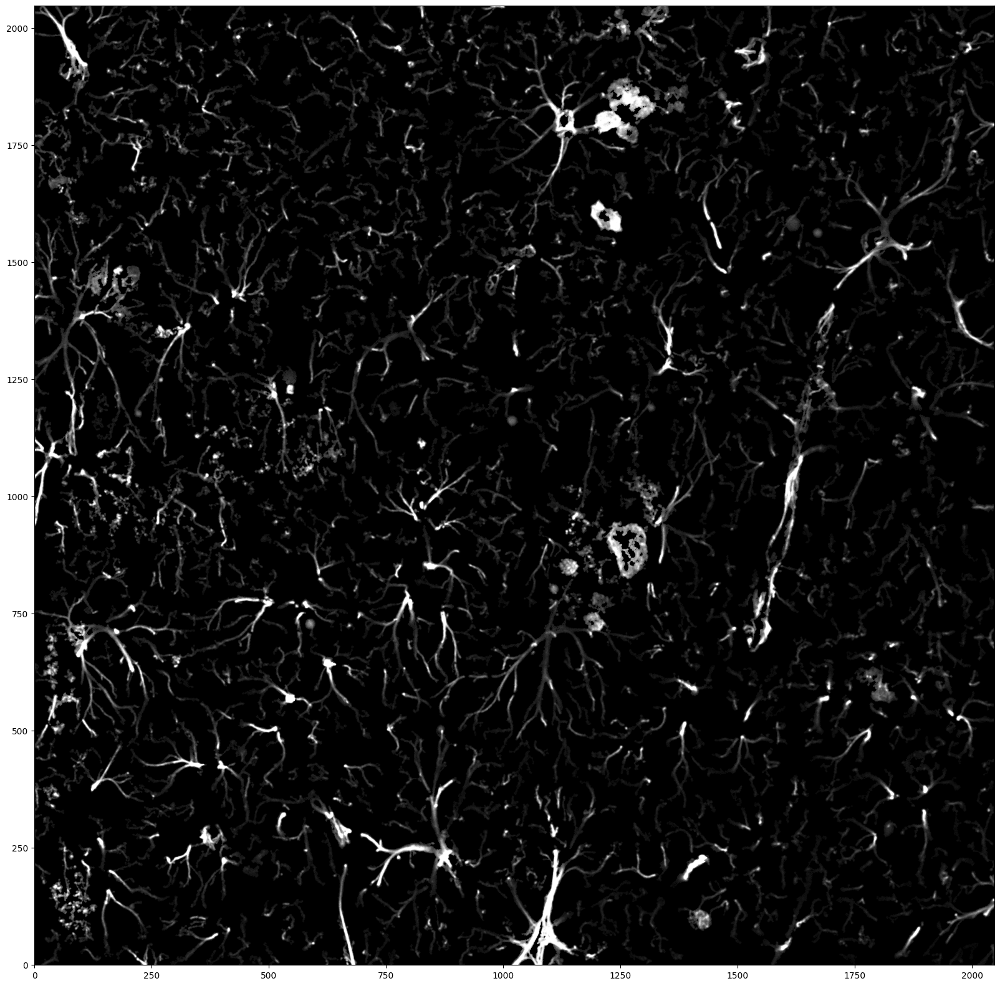

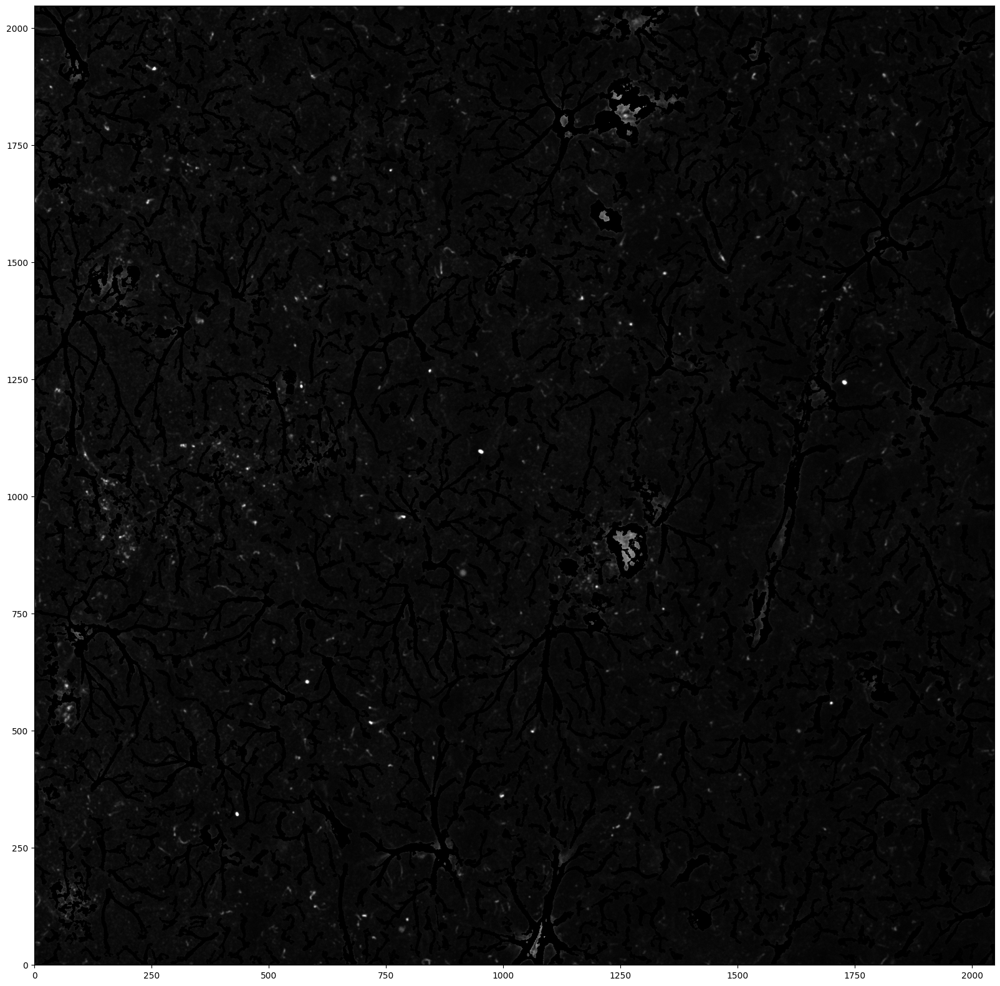

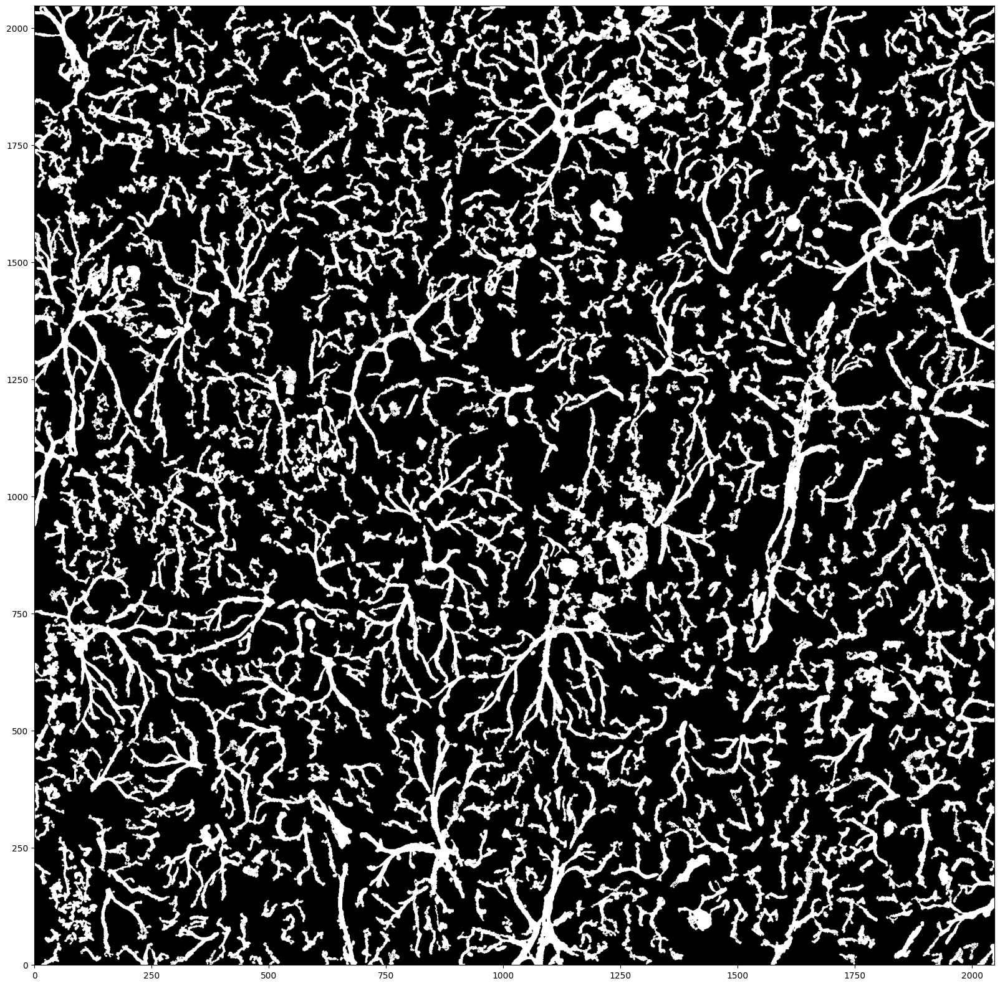

In [11]:
skeleton = images[tid, :, :]

cur = np.log(skeleton.astype('float64'))
cur -= cur.min()
mx = 2 ** 16 - 1
cur *= mx / np.quantile(cur.flatten(), 0.99)
cur = np.minimum(cur, mx)
cur = cur.astype('uint16')
#import scipy
x = cur.flatten()
#print(np.quantile(x, [0.25, 0.5, 0.8]))

#cur = fil.flat_img.value.copy()

thr = np.quantile(x, 0.7)

#cur[cur < thr] = 0

cur = cv2.adaptiveThreshold((cur / 256).astype('uint8'), maxValue = 1, adaptiveMethod = cv2.ADAPTIVE_THRESH_MEAN_C, \
                      thresholdType = cv2.THRESH_BINARY, blockSize = 41, C = -1)

cur = remove_small(cur, min_size = 50)

cur = remove_alone(cur, num_iter = 100)
#cur = remove_small(cur, min_size = 300)
#cur = remove_small(cur, min_size = 300)

#cur = fill_holes(cur)
cur = remove_small(cur, min_size = 300)
#kernel = np.ones((3,3),np.uint8)
#erosion = cv2.erode(cur,kernel,iterations = 1)
#cur = cv2.morphologyEx(cur, cv2.MORPH_OPEN, kernel)

im_structure = skeleton.copy()
im_structure[cur == 0] = 0

plt.figure(figsize = (20, 20))
plt.imshow(skeleton, cmap='gray', origin='lower')


plt.figure(figsize = (20, 20))

#plt.imshow(cur, cmap='gray', origin='lower')
plt.imshow(im_structure, cmap='gray', origin='lower')

plt.figure(figsize = (20, 20))
im_structure = skeleton.copy()
im_structure[cur != 0] = 0
plt.imshow(im_structure, cmap='gray', origin='lower')

plt.figure(figsize = (20, 20))
plt.imshow(cur, cmap='gray', origin='lower')

bw_branches = cur.copy()


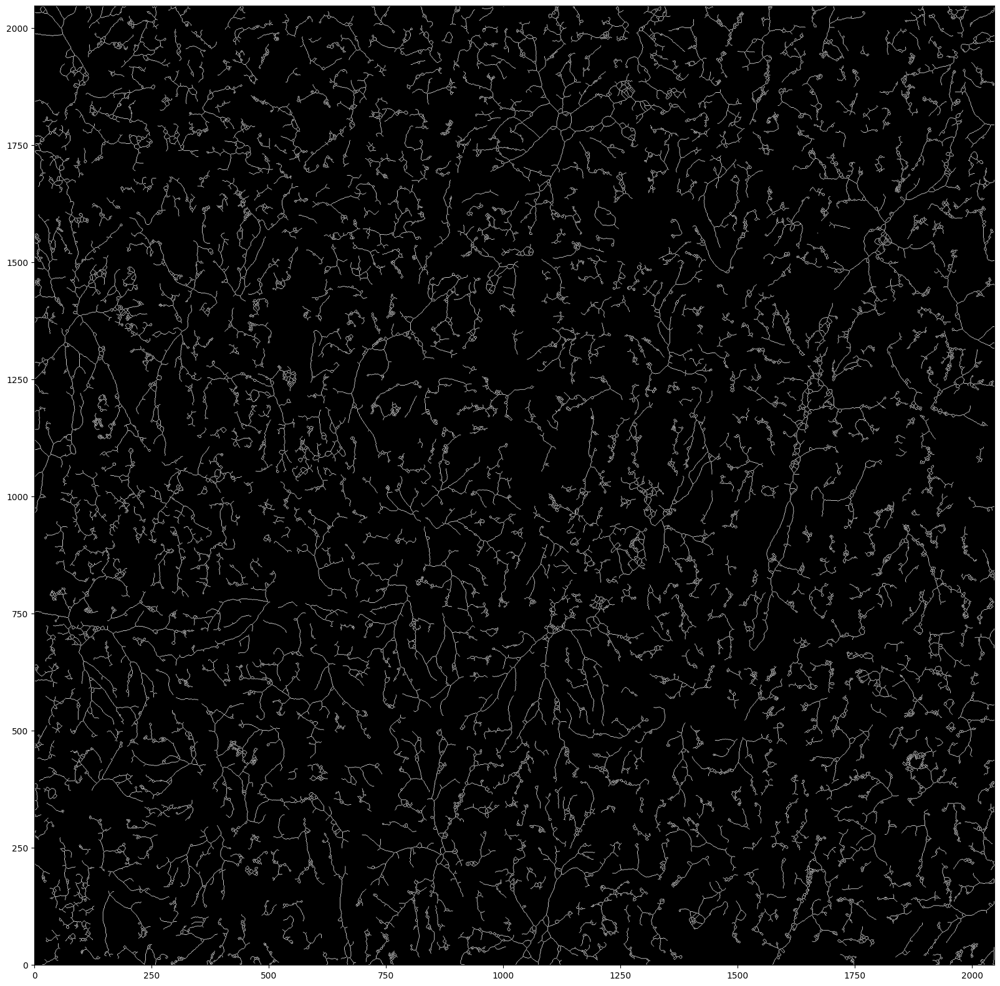

In [12]:
im_structure = skeleton.copy()
im_structure[cur == 0] = 0
fil = FilFinder2D(im_structure, distance=250 * u.pix, mask=im_structure)
fil.medskel(verbose=False)
plt.figure(figsize = (20, 20))
plt.imshow(fil.skeleton, cmap='gray', origin='lower')


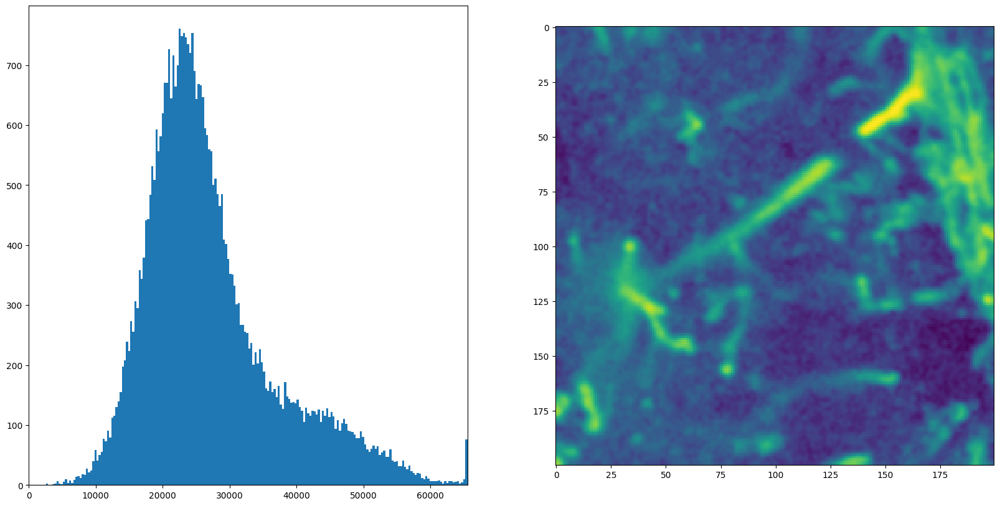

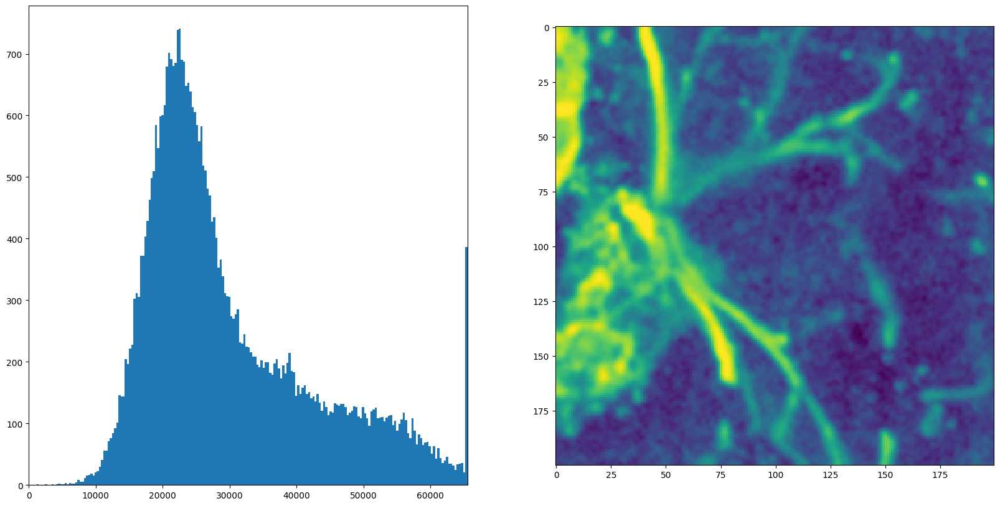

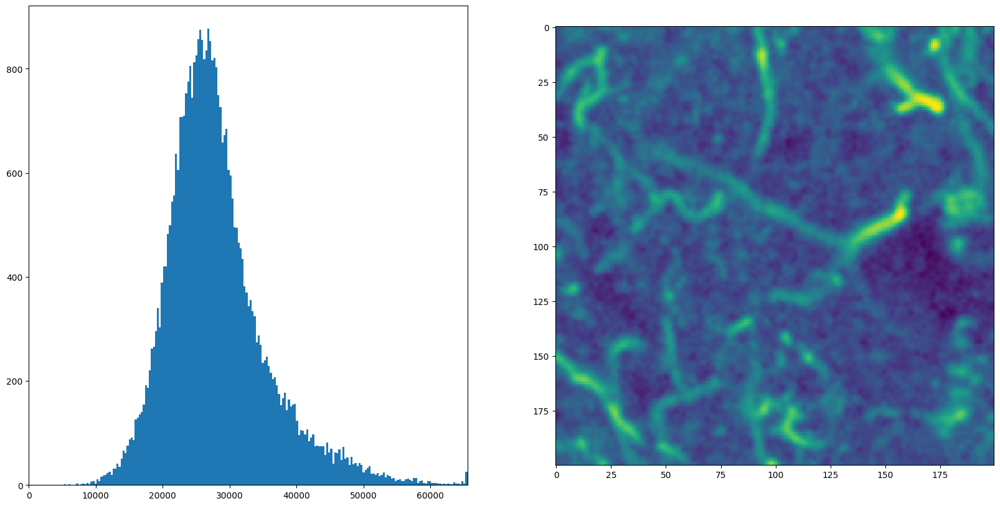

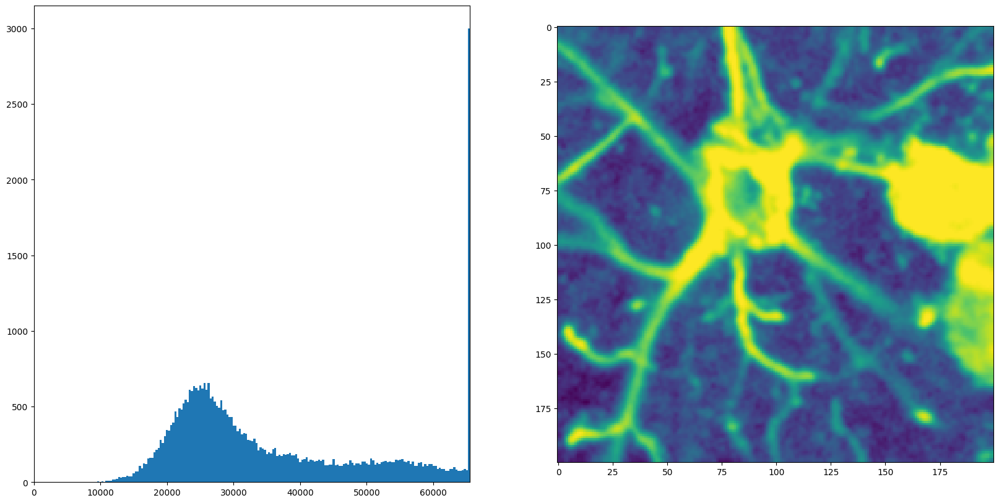

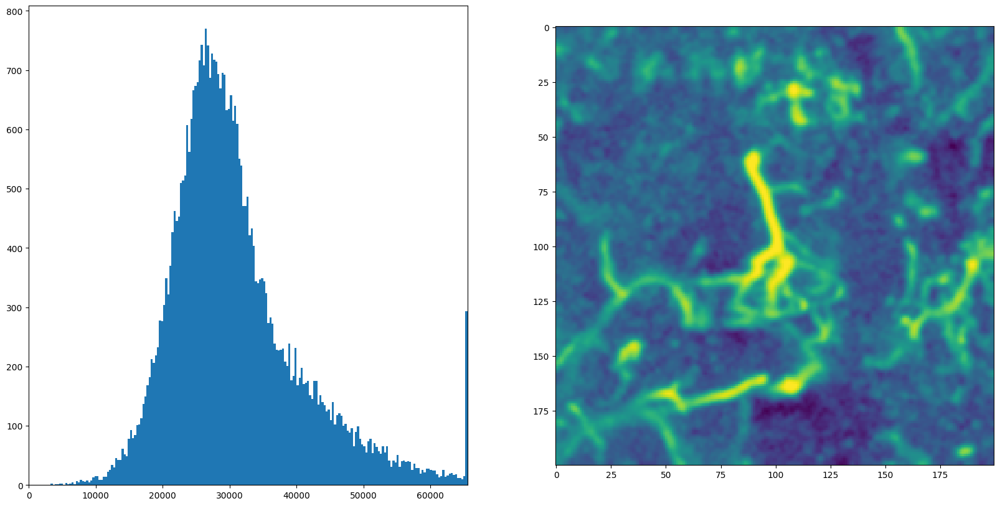

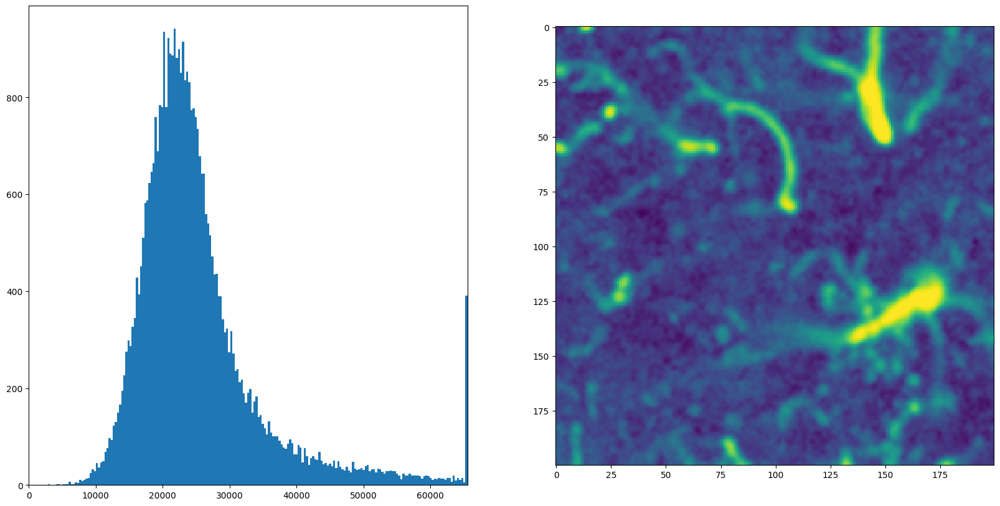

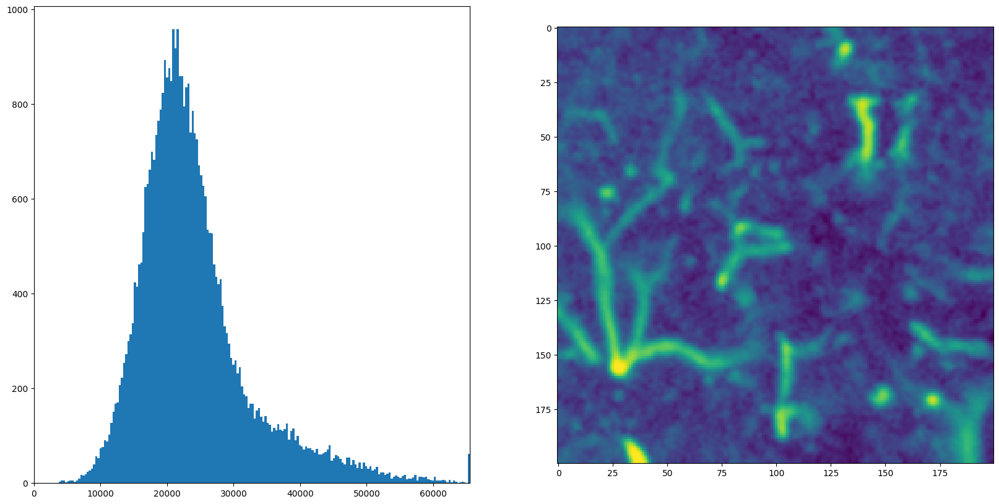

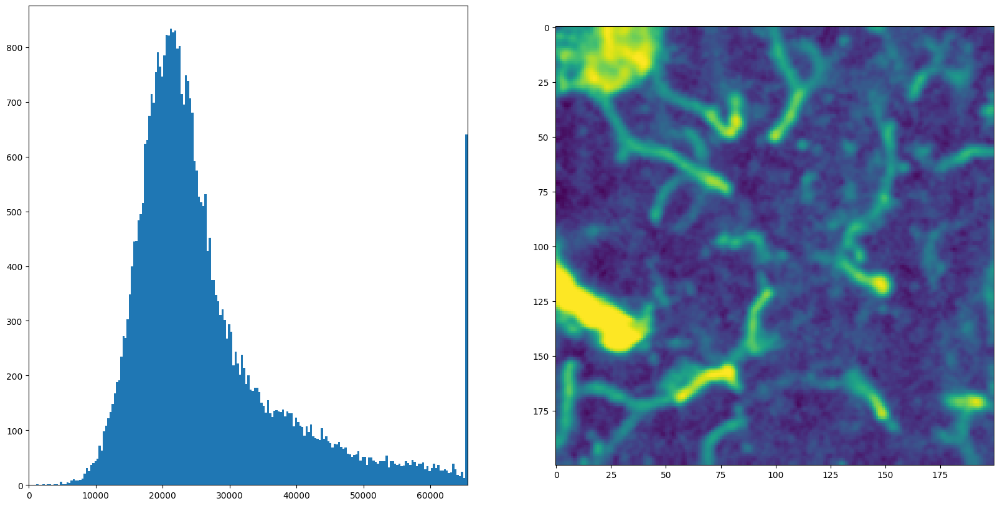

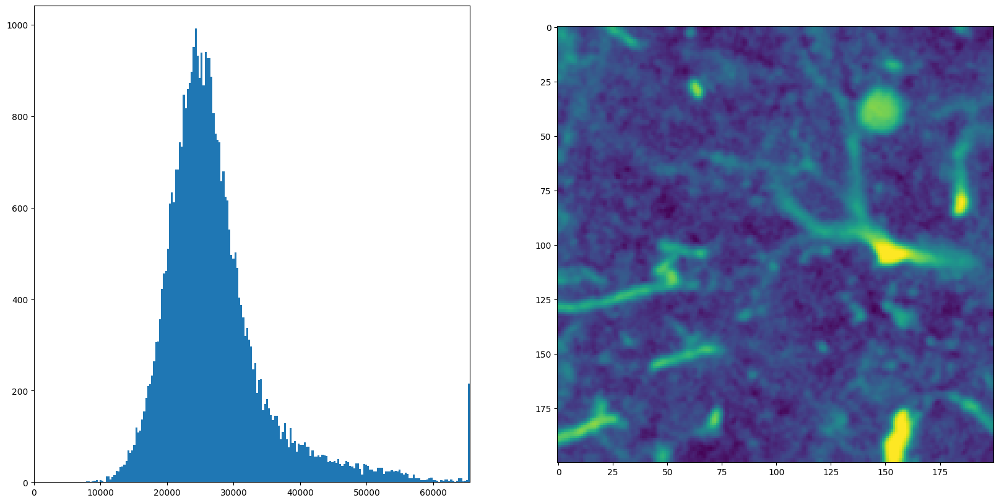

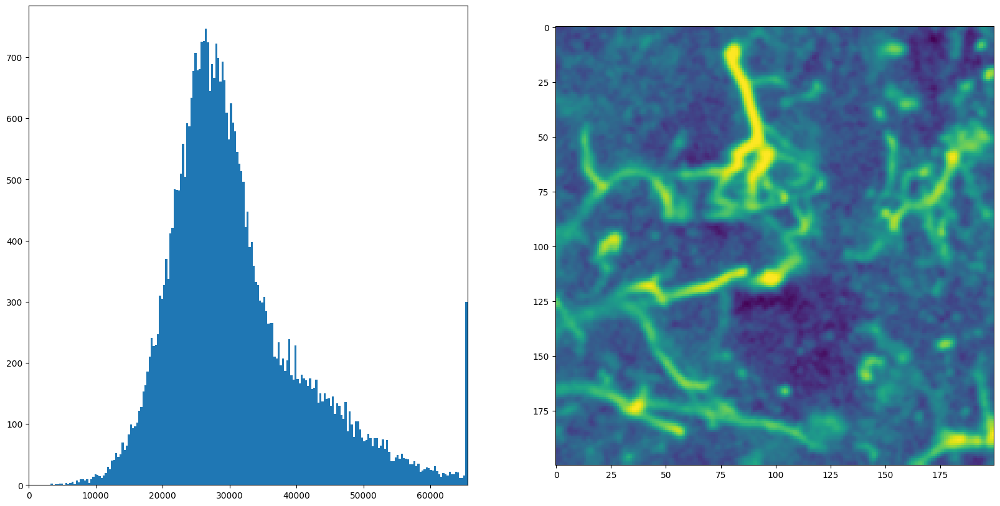

In [13]:
skeleton = images[tid, :, :]

cur = np.log(skeleton.astype('float64'))
cur -= cur.min()
mx = 2 ** 16 - 1
cur *= mx / np.quantile(cur.flatten(), 0.99)
cur = np.minimum(cur, mx)
cur = cur.astype('uint16')

w = 200
np.random.seed(42)
for k in range(10):
    x = np.random.randint(cur.shape[0] - w)
    y = np.random.randint(cur.shape[0] - w)
    plt.figure(figsize = (20, 10))
    plt.subplot(121)
    plt.hist(cur[x:x+w, y:y+w].flatten(), bins = 200)
    plt.xlim([0, mx])
    plt.subplot(122)
    imgx = cur[x:x+w, y:y+w].copy()
    imgx = cv2.GaussianBlur(imgx,(3,3),1)
    plt.imshow(imgx)
    #plt.yscale('log')
    #plt.xscale('log')
    pass

In [14]:
np.sum(cur < 255)

2

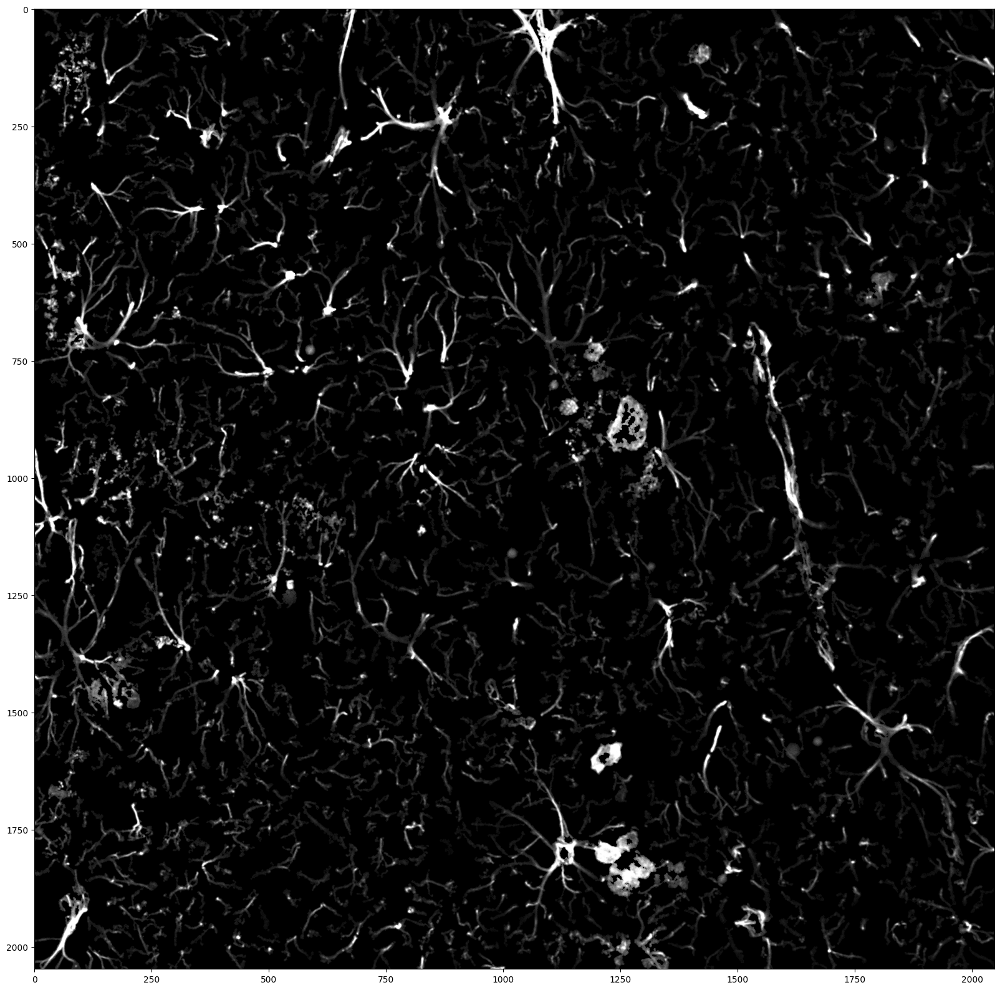

In [15]:
plt.figure(figsize = (20, 20))
plt.imshow(fil.mask, cmap='gray')


In [16]:
!pip install fil_finder

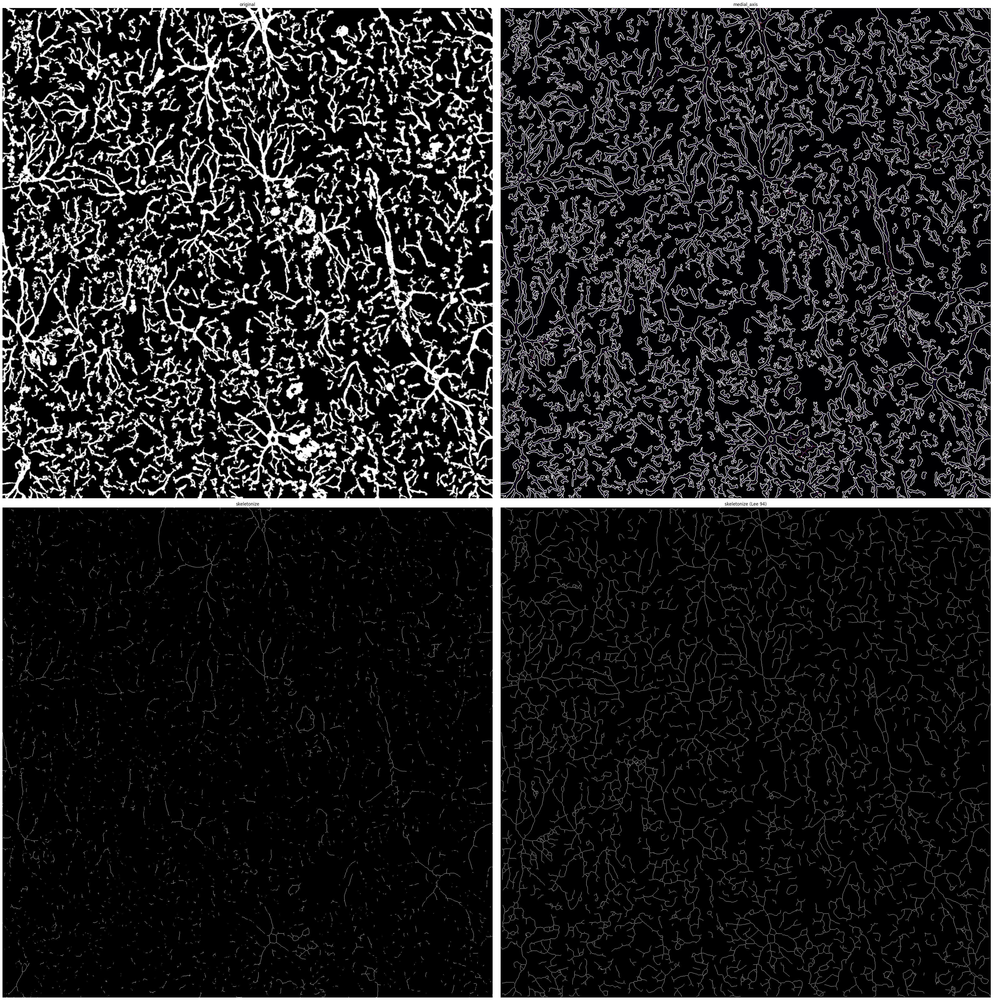

In [17]:
from skimage.morphology import medial_axis, skeletonize
from skimage import data

#blobs = im[tid, :500, :500].copy() > 3000
blobs = bw_branches.copy()
blobs = cv2.GaussianBlur(blobs, (7, 7), 1)

# Compute the medial axis (skeleton) and the distance transform
skel, distance = medial_axis(blobs, return_distance=True)

# Compare with other skeletonization algorithms
skeleton = skeletonize(blobs)
skeleton_lee = skeletonize(blobs, method='lee')

# Distance to the background for pixels of the skeleton
dist_on_skel = distance * skel

fig, axes = plt.subplots(2, 2, figsize=(40, 40), sharex=True, sharey=True)
ax = axes.ravel()

ax[0].imshow(blobs, cmap=plt.cm.gray)
ax[0].set_title('original')
ax[0].axis('off')

ax[1].imshow(dist_on_skel, cmap='magma')
ax[1].contour(blobs, [0.5], colors='w')
ax[1].set_title('medial_axis')
ax[1].axis('off')

ax[2].imshow(skeleton, cmap=plt.cm.gray)
ax[2].set_title('skeletonize')
ax[2].axis('off')

ax[3].imshow(skeleton_lee, cmap=plt.cm.gray)
ax[3].set_title("skeletonize (Lee 94)")
ax[3].axis('off')

fig.tight_layout()
plt.show()

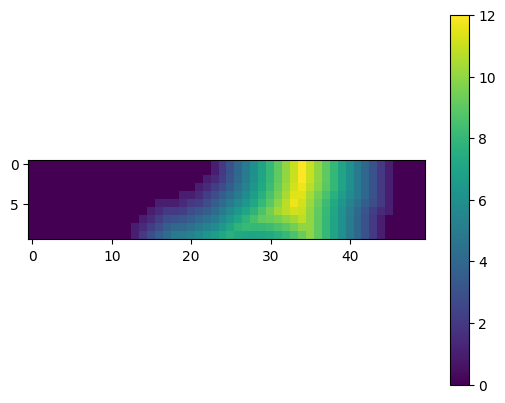

In [18]:
plt.imshow(distance[:10, 200:250])
plt.colorbar()

In [19]:
distance[4, 200:250].T

array([ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  1.        ,
        1.        ,  1.41421356,  2.23606798,  2.82842712,  3.60555128,
        4.24264069,  5.        ,  5.83095189,  6.70820393,  7.61577311,
        8.54400375,  9.48683298, 10.44030651, 11.40175425, 11.40175425,
       10.44030651,  9.48683298,  8.54400375,  7.61577311,  6.70820393,
        5.83095189,  5.        ,  4.        ,  3.        ,  2.        ,
        1.        ,  0.        ,  0.        ,  0.        ,  0.        ])

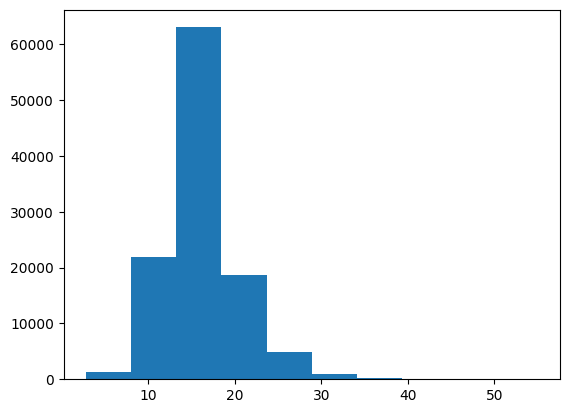

In [20]:
plt.hist(distance[skeleton_lee != 0] * 2)
pass